# Keras Baseline Engine for VAS Challenge 2019

## Imports

In [1]:
import os
import sys
import scipy
import glob
import tqdm
import keras
import random
import soundfile as sf   
import librosa
from scipy import signal
import numpy as np
import pandas as pd
import librosa.display
import tensorflow as tf
from matplotlib import patches
from matplotlib import pyplot as plt
import pickle
from multiprocessing import Pool, cpu_count
import gc
import cv2 as cv
import numba
# Local file import
import DftSpectrogram
import Metrics

config = tf.ConfigProto()
config.gpu_options.allow_growth = False
sess = tf.Session(config=config)
tf.logging.set_verbosity(tf.logging.ERROR)

print("Done!")
import warnings
warnings.filterwarnings('ignore')
sys.path.append('/home/ilya/Documents/kaggle/Spec_boosters')

import image_processers as ip

Using TensorFlow backend.


Done!


## Path to train dataset dir

In [2]:
dataset_dir = "/home/ilya/Documents/kaggle/audio/Training_Data/LibriSpeech"
train_dataset_dir = os.path.join(dataset_dir, "train-clean-100")

!tree {train_dataset_dir} -L 1

/home/ilya/Documents/kaggle/audio/Training_Data/LibriSpeech/train-clean-100
├── 103
├── 1034
├── 1040
├── 1069
├── 1081
├── 1088
├── 1098
├── 1116
├── 118
├── 1183
├── 1235
├── 1246
├── 125
├── 1263
├── 1334
├── 1355
├── 1363
├── 1447
├── 1455
├── 150
├── 1502
├── 1553
├── 1578
├── 1594
├── 1624
├── 163
├── 1723
├── 1737
├── 1743
├── 1841
├── 1867
├── 1898
├── 19
├── 1926
├── 196
├── 1963
├── 1970
├── 198
├── 1992
├── 200
├── 2002
├── 2007
├── 201
├── 2092
├── 211
├── 2136
├── 2159
├── 2182
├── 2196
├── 226
├── 2289
├── 229
├── 233
├── 2384
├── 2391
├── 2416
├── 2436
├── 248
├── 250
├── 2514
├── 2518
├── 254
├── 26
├── 2691
├── 27
├── 2764
├── 2817
├── 2836
├── 2843
├── 289
├── 2893
├── 2910
├── 2911
├── 2952
├── 298
├── 2989
├── 302
├── 307
├── 311
├── 3112
├── 3168
├── 32
├── 3214
├── 322
├── 3235
├── 3240
├── 3242
├── 3259
├── 328
├── 332
├── 3374
├── 3436
├── 3440
├── 3486
├── 3526
├── 3607
├── 3664
├── 3699
├── 3723
├── 374
├── 3807
├── 3830
├── 3857
├── 3879
├── 39
├── 3947
├── 3

In [3]:
g_train = sorted(glob.glob(os.path.join(train_dataset_dir, '*.wav'), recursive=True))

In [4]:
len(g_train)

0

In [5]:
libri_data = sorted(glob.glob(os.path.join(train_dataset_dir, '**/**/*.flac'), recursive=True))

In [6]:
libri_data = list(set(libri_data))

## File paths

In [5]:
random.seed(42)

In [19]:
wav_paths = sorted(glob.glob(os.path.join(train_dataset_dir, '**/*.wav'), recursive=True))
random.shuffle(wav_paths)

train_paths = wav_paths[:40000]
dev_paths = wav_paths[40000:]

train_human  = sorted(filter(lambda path: "human" in path, wav_paths))
train_spoof = sorted(filter(lambda path: "spoof" in path, wav_paths))

print("Train Human: %d" % len(train_human))
print("Train Spoof: %d" % len(train_spoof))

Train Human: 10322
Train Spoof: 39678


In [20]:
g_small = sorted(glob.glob(os.path.join(train_dataset_dir, '*.wav'), recursive=True))

In [49]:
finall_dict = {}
for _, row in g_dev_map.iterrows():
    if 'LA_D_A1045602' in row[1]:
        print("kik")
    if finall_dict.get(row[1]) is not None:
        print("Lol")
    finall_dict[row[1]] = row[4]
    
for _, row in g_train_map.iterrows():
    if 'LA_D_A1045602' in row[1]:
        print("kik")
    if finall_dict.get(row[1]) is not None:
        print("Lol")
    finall_dict[row[1]] = row[4]
    
for _, row in g_eval_map.iterrows():
    if 'LA_D_A1045602' in row[1]:
        print("kik")
    if finall_dict.get(row[1]) is not None:
        print("Lol")
    finall_dict[row[1]] = row[4]

In [50]:
set(finall_dict.values())

{'bonafide', 'spoof'}

In [51]:
google_spoof = []
google_human = []
for listik in [g_train,g_dev,g_eval]:
    for _,i in enumerate(listik):
        if i[-17] == 'L':
            if finall_dict.get(i[-17:-5]) == 'bonafide':
                google_human.append(i) 
                
            else:
                google_spoof.append(i)
                
        else:
            if finall_dict.get('L'+i[-17:-5]) == 'bonafide':
                google_human.append(i)   
            
            else:
                google_spoof.append(i)

In [57]:
pickle.dump(google_human,open('human_map', 'wb'))
pickle.dump(google_spoof,open('spoof_map', 'wb'))

In [11]:
google_human = pickle.load(open('human_map','rb'))
google_spoof = pickle.load(open('spoof_map','rb'))

## Обработаем мои аудио

In [7]:
saver = ip.make_saver(ip.spec_builder)
transformer = ip.make_transformer(saver,'../../Training_Data/mine/large')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(wav_paths, 4)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()


saver = ip.make_saver(ip.spec_builder_small)
transformer = ip.make_transformer(saver,'../../Training_Data/mine/small')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(wav_paths, 4)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

### Спектрограмма моего голоса добавленна
# Теперь Antispoof C


In [62]:
saver = ip.make_saver(ip.spec_builder)
transformer = ip.make_transformer(saver,'../../Training_Data/LA/spoof/large')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(google_spoof, 4)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()


saver = ip.make_saver(ip.spec_builder_small)
transformer = ip.make_transformer(saver,'../../Training_Data/LA/spoof/small')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(google_spoof, 4)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

In [10]:
len(libri_data)

28539

In [7]:
saver = ip.make_saver(ip.spec_builder)
transformer = ip.make_transformer(saver,'../../Training_Data/LibriSpeech/large')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(libri_data, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()


saver = ip.make_saver(ip.spec_builder_small)
transformer = ip.make_transformer(saver,'../../Training_Data/LibriSpeech/small')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(libri_data, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

In [15]:
saver = ip.make_saver(ip.spec_builder)
transformer = ip.make_transformer(saver,'../../Training_Data/human_')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(train_human, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

transformer = ip.make_transformer(saver,'../../Training_Data/spoof_')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(train_spoof, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

In [13]:
saver = ip.make_saver(ip.spec_builder_small)
transformer = ip.make_transformer(saver,'../../Training_Data/human_small/')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(train_human, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

transformer = ip.make_transformer(saver,'../../Training_Data/spoof_small/')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(train_spoof, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

In [10]:
google = sorted(glob.glob(os.path.join(train_dataset_dir, 'ASVspoof2017_V2_train/**/*.wav'), recursive=True))

In [12]:
len(google)

3014

In [13]:
saver = ip.make_saver(ip.spec_builder_small)
transformer = ip.make_transformer(saver,'../../Training_Data/google_small/Small')

def work(data,transformer=transformer):
    transformer(data)

df_split = np.array_split(google, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

In [14]:
saver = ip.make_saver(ip.spec_builder)
transformer = ip.make_transformer(saver,'../../Training_Data/google_small/Large')

def work(data,transformer=transformer):
    transformer(data)
df_split = np.array_split(google, 8)
pool = Pool(8)
pool.map(work, df_split)
pool.close()
pool.join()

## Raw Feature Extractor 

(66000,)


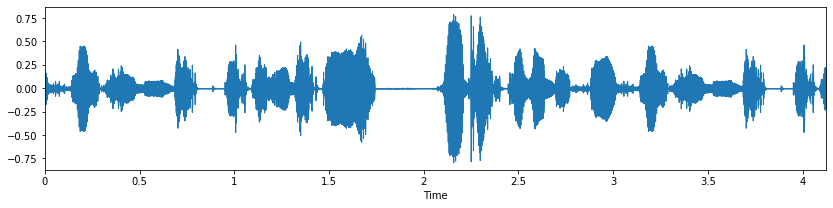

In [22]:
def extract_wav(wav_path):
    sr, x = scipy.io.wavfile.read(wav_path)
    return sr, x
    
def extract_flax(wav_path):
    x, sr = sf.read(wav_path)  
    return sr, x

def get_feature(wav_path, length=66000, random_start=False, extractor=extract_wav):
    try:
        sr, x = extractor(wav_path)
        assert sr == 16000
        if length > len(x):
            x = np.concatenate([x] * int(np.ceil(length/len(x))))
        if random_start:
            x = x[random.randint(0, len(x) - length):]
        feature = x[:length]
        return feature / np.max(np.abs(feature))
    except Exception as e:
        print("Error with getting feature from %s: %s" % (wav_path, str(e)))
        return None

feature = get_feature(random.choice(train_human), length=66000, random_start=True)
plt.figure(figsize=(14, 3))
librosa.display.waveplot(feature, sr=16000)
print(feature.shape)

In [8]:
def spec_builder(wav):
    D_1 = librosa.stft(wav,n_fft=256, hop_length=1056)  
    return abs(D_1)

In [13]:
___ = spec_builder(feature)

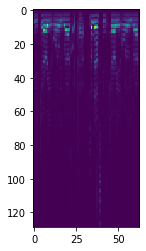

In [14]:
plt.imshow(___)

In [66]:
mel_spec.tofile('kek')

In [67]:
type(mel_spec)

numpy.ndarray

In [69]:
np.fromfile('kek').reshape(128,256) == mel_spec

array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True]])

## Train Data Generator

2356
(16, 66000, 1)
(16, 2)


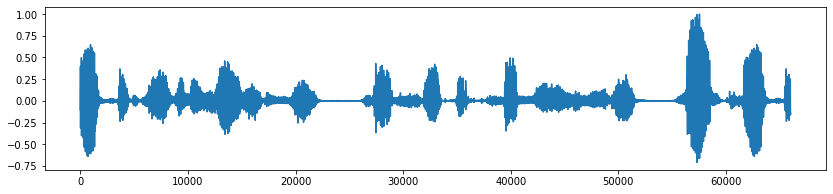

In [6]:
class DataGenerator(keras.utils.Sequence):
    def __init__(self, human_paths, spoof_paths, feature_extractor,
                 batch_size=16, amin=0.01,ref=np.mean,n_fft=700,afine=None):
        self.human_paths = human_paths
        self.spoof_paths = spoof_paths
        self.batch_size = batch_size
        self.feature_extractor = feature_extractor
        self.n_samples = len(self.human_paths) + len(self.spoof_paths)
        self.on_epoch_end()
        self.n_fft = n_fft
        self.amin = amin
        self.ref = ref
        self.afine = afine
        
    def __len__(self):
        return int(np.floor(self.n_samples / self.batch_size))
    
    def __getitem__(self, index):
        return self.data_generation()
        
    def on_epoch_end(self):
        random.shuffle(self.human_paths)
        random.shuffle(self.spoof_paths)
    
    def data_generation(self):
        wavs, labels = [], []
        while len(wavs) < self.batch_size // 2:
            wav = self.feature_extractor(random.choice(self.human_paths))
            if wav is not None:
                wavs.append(wav)
                labels.append(0)
        while len(wavs) < self.batch_size:
            wav = self.feature_extractor(random.choice(self.spoof_paths))
            if wav is not None:
                wavs.append(wav)
                labels.append(1)

        return np.stack(wavs, 0)[..., np.newaxis], keras.utils.to_categorical(np.stack(labels, 0), num_classes=2)

train_get_feature = lambda path: get_feature(path, length=66000, random_start=True)
train_data_generator = DataGenerator(train_human, train_spoof, train_get_feature, batch_size=16)
features, labels = train_data_generator[0]
plt.figure(figsize=(14, 3))
plt.plot(features[0])
print(len(train_data_generator))
print(features.shape)
print(labels.shape)

## Dev Data Generator

12301
(1, 66000, 1)
(1, 2)


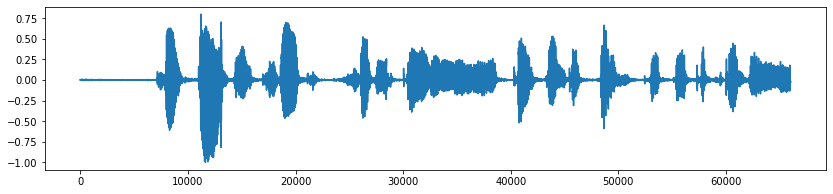

In [7]:
class DevDataGenerator(keras.utils.Sequence):
    def __init__(self, human_paths, spoof_paths, feature_extractor,
                 amin=0.01,ref=np.mean,n_fft=700):
        self.human_paths = human_paths
        self.spoof_paths = spoof_paths
        self.paths = human_paths + spoof_paths
        self.labels = [0] * len(human_paths) + [1] * len(spoof_paths)
        self.feature_extractor = feature_extractor
        self.n_fft = n_fft
        self.amin = amin
        self.ref = ref
        
    def __len__(self):
        return len(self.paths)
    
    
    def __getitem__(self, index):
        feature = self.feature_extractor(self.paths[index])
        return feature[np.newaxis,..., np.newaxis], keras.utils.to_categorical([self.labels[index]], num_classes=2)
        
dev_get_feature = lambda path: get_feature(path, length=66000, random_start=False)
dev_data_generator = DevDataGenerator(dev_human, dev_spoof, dev_get_feature)
features, labels = dev_data_generator[0]
plt.figure(figsize=(14, 3))
plt.plot(features[0])
print(len(dev_data_generator))
print(features.shape)
print(labels.shape)

## Build Model

In [6]:
from keras.models import Sequential, Model
from keras.layers import (Conv2D,MaxPooling2D,Dropout,Dense,BatchNormalization,Input,Flatten, Reshape,
                          AveragePooling2D,Conv1D,Concatenate,Add, GlobalMaxPool2D)
from keras.optimizers import Adam, SGD
from keras.callbacks import LearningRateScheduler

In [22]:
def create_model(shape):
    Model_input = Input(shape=shape, name='Inputer')
    conv = Conv2D(60, kernel_size=3, activation='relu', name='Conv1')(Model_input)
    conv = Conv2D(60, kernel_size=3, activation='relu', name='Conv1_1')(conv)
    m_pooling = MaxPooling2D((2,3), name='MaxPooling1')(conv)
    b_n = BatchNormalization(name='BatchNorm1')(m_pooling)
    drop = Dropout(0.1 ,name='Drop1')(b_n)
    conv = Conv2D(60, kernel_size=4, activation='relu', name='Conv2')(drop)
    
#first block
    bl1_1 = Conv2D(10, kernel_size=(1,1), activation='relu', name = 'bl1_1')(conv)
    bl1_2 = Conv2D(10, kernel_size=(3,3), padding='same', activation='relu', name = 'bl1_2')(conv)
    bl1_3 = Conv2D(10, kernel_size=(5,5), padding='same', activation='relu', name = 'bl1_3')(conv)
    blq_4 = Concatenate(3, name='bl1_CONCAT')([bl1_1,bl1_2,bl1_3])
    blq_5 = MaxPooling2D((2,3), name='bl1_MP')(blq_4)
    
    m_pooling = MaxPooling2D((2,3), name='MaxPooling2')(conv)
    conc = Concatenate(3, name='Concatenate')([m_pooling,blq_5])
    b_n = BatchNormalization(name='BatchNorm2')(conc)
    drop = Dropout(0.1 ,name='Drop2')(b_n)
    conv = Conv2D(50, kernel_size=(1,1), activation='relu', name='Conv3')(drop)
    b_n = BatchNormalization(name='BatchNorm3')(conv)
    drop = Dropout(0.1 ,name='Drop3')(b_n)
    m_pooling = MaxPooling2D(3, name='MaxPooling3')(drop)
    conv = Conv2D(50, kernel_size=(3,3), activation='relu', name='Conv4')(m_pooling)
    b_n = BatchNormalization(name='BatchNorm4')(conv)
    drop = Dropout(0.1 ,name='Drop4')(b_n)
    conv = Conv2D(50, kernel_size=(3,3), activation='relu', name='Conv5')(drop)
    b_n = BatchNormalization(name='BatchNorm5')(conv)
    drop = Dropout(0.1 ,name='Drop5')(b_n)
    conv = Conv2D(15, kernel_size=(3,3), activation='relu', name='Conv6')(drop)
    g_pooling = GlobalMaxPool2D(name='G_pooling')(conv)
    out = Dense(2, activation='softmax')(g_pooling)
    model = Model(inputs=Model_input, outputs=out)
    model.summary()
    return model


model = create_model((128, 256,1))

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
Inputer (InputLayer)            (None, 128, 256, 1)  0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 126, 254, 60) 600         Inputer[0][0]                    
__________________________________________________________________________________________________
Conv1_1 (Conv2D)                (None, 124, 252, 60) 32460       Conv1[0][0]                      
__________________________________________________________________________________________________
MaxPooling1 (MaxPooling2D)      (None, 62, 84, 60)   0           Conv1_1[0][0]                    
__________________________________________________________________________________________________
BatchNorm1

## Callbacks

In [8]:
def exp_decay(epoch, k=0.3, initial_rate=0.01):
    return initial_rate * np.exp(-k * (epoch//2)**1.4)

class Saver(keras.callbacks.Callback):
    def __init__(self, temp_models_dir):
        super().__init__()
        self.temp_models_dir = temp_models_dir
    def on_train_begin(self, logs={}):
        !mkdir -p {self.temp_models_dir}
        !rm {self.temp_models_dir}/*
    def on_epoch_end(self, epoch, logs={}):
        model.save("%s/model_epoch_%d.h5" % (self.temp_models_dir, epoch + 1))
        
class Eer(keras.callbacks.Callback):
    def __init__(self, dev_data_generator):
        super().__init__()
        self.dev_data_generator = dev_data_generator
        self.val_eers = None
    def on_train_begin(self, logs={}):
        self.val_eers = []
    def on_epoch_end(self, epoch, logs):
        results = model.predict_generator(self.dev_data_generator, verbose=1)
        human = results[:len(self.dev_data_generator.human_paths), 0]
        spoof = results[len(self.dev_data_generator.human_paths):, 0]
        val_eer = Metrics.compute_err(human, spoof)[0]
        self.val_eers.append(val_eer)
        logs["val_eer"] = val_eer
        print("%sEER = %0.3f%%" % (" "*20, val_eer))

learning_rate   = keras.callbacks.LearningRateScheduler(exp_decay)
saver           = Saver("./temp_models/")
eer             = Eer(dev_data_generator)
        
callbacks     = [learning_rate, saver, eer]
print("Total %d callbacks" % len(callbacks))

Total 3 callbacks


## Train Model

In [52]:
model = keras.models.load_model('custom/model_epoch_2.h5')

In [26]:
model.layers.pop()
model.layers.pop()

In [28]:
model2 = keras.Model(model.input, model.layers[-1].output)
model2.predict(features).shape

(1, 1, 3, 25)

In [43]:
Model_input = Input(shape=(128, 256,1), name='Inputer')
_ = model2(Model_input)
model2.trainable=False

conv = Conv2D(5, kernel_size=(1,1), activation='relu', name='Conv4')(_)
b_n = BatchNormalization(name='BatchNorm4')(conv)
drop = Dropout(0.1 ,name='Drop4')(b_n)
r = Reshape((-1,))(drop)
out = Dense(2,activation='softmax')(r)

model3 = keras.Model(Model_input, out)


In [77]:
model3.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
Inputer (InputLayer)         (None, 128, 256, 1)       0         
_________________________________________________________________
model_1 (Model)              (None, 1, 3, 25)          106225    
_________________________________________________________________
Conv4 (Conv2D)               (None, 1, 3, 5)           130       
_________________________________________________________________
BatchNorm4 (BatchNormalizati (None, 1, 3, 5)           20        
_________________________________________________________________
Drop4 (Dropout)              (None, 1, 3, 5)           0         
_________________________________________________________________
reshape_5 (Reshape)          (None, 15)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 32        
Total para

In [81]:
model3.save('last.h5')

In [86]:
model3.compile(loss="categorical_crossentropy", optimizer=keras.optimizers.Adam(lr=1e-3, decay=0.000004),
              metrics=['accuracy'])

callbacks = [saver,learning_rate,eer]
model3.fit_generator(train_data_generator,
                            steps_per_epoch = None,
                            epochs = 2,
                            callbacks = callbacks,
                            use_multiprocessing = True,
                            workers = 8,
                            )

rm: cannot remove './temp_models//*': No such file or directory
Epoch 1/2
10000/10000 [==============================] - 2383s 238ms/step
                    EER = 1.451%
Epoch 2/2
 131/2500 [>.............................] - ETA: 48:05 - loss: 0.0456 - acc: 0.9852

Process ForkPoolWorker-137:
Process ForkPoolWorker-131:
Process ForkPoolWorker-134:
Process ForkPoolWorker-136:
Process ForkPoolWorker-132:
  File "/home/ilya/anaconda3/lib/python3.7/multiprocessing/pool.py", line 121, in worker
    result = (True, func(*args, **kwds))
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/ilya/anaconda3/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/ilya/anaconda3/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/ilya/anaconda3/lib/python3.7/multiprocessing/process.py", line 297, in _bootstrap
    self.run()
  File "/home/ilya/anaconda3/lib/python3.7/multiprocessing/process.py", line 99, in run
    self._target(*self._args, **self._kwargs)
  File "/home/ilya/anaconda3/lib/python3.7/multiprocessing/process.py", line 297, in _bo

KeyboardInterrupt: 

  File "<ipython-input-74-56303ebdd81a>", line 50, in <lambda>
    train_get_feature = lambda path: get_feature(path, length=66000, random_start=True)
  File "/home/ilya/anaconda3/lib/python3.7/ctypes/util.py", line 333, in find_library
    _get_soname(_findLib_gcc(name) or _findLib_ld(name))
  File "<ipython-input-14-75a62650b3cb>", line 3, in get_feature
    x, sr = librosa.load(wav_path, sr=None)
  File "/home/ilya/anaconda3/lib/python3.7/ctypes/util.py", line 333, in find_library
    _get_soname(_findLib_gcc(name) or _findLib_ld(name))
  File "/home/ilya/.local/lib/python3.7/site-packages/librosa/core/audio.py", line 119, in load
    with audioread.audio_open(os.path.realpath(path)) as input_file:
  File "/home/ilya/anaconda3/lib/python3.7/ctypes/util.py", line 301, in _findLib_ld
    universal_newlines=True)
  File "/home/ilya/anaconda3/lib/python3.7/subprocess.py", line 775, in __init__
    restore_signals, start_new_session)
  File "<ipython-input-74-56303ebdd81a>", line 50, in 

  File "<ipython-input-14-75a62650b3cb>", line 3, in get_feature
    x, sr = librosa.load(wav_path, sr=None)
  File "/home/ilya/anaconda3/lib/python3.7/subprocess.py", line 775, in __init__
    restore_signals, start_new_session)
  File "/home/ilya/.local/lib/python3.7/site-packages/librosa/core/audio.py", line 119, in load
    with audioread.audio_open(os.path.realpath(path)) as input_file:
  File "/home/ilya/anaconda3/lib/python3.7/subprocess.py", line 1453, in _execute_child
    restore_signals, start_new_session, preexec_fn)
  File "/home/ilya/.local/lib/python3.7/site-packages/audioread/__init__.py", line 107, in audio_open
    backends = available_backends()
KeyboardInterrupt
  File "/home/ilya/.local/lib/python3.7/site-packages/audioread/__init__.py", line 86, in available_backends
    if ffdec.available():
  File "<ipython-input-74-56303ebdd81a>", line 42, in data_generation
    wav = self.feature_extractor(random.choice(self.spoof_paths))
  File "/home/ilya/.local/lib/python3.

## Load best checkpoint

In [46]:
best_checkpoint = np.argmin(eer.val_eers)
print("Best checkpoint - Epoch %d: EER = %0.3f%%" % (best_checkpoint + 1, eer.val_eers[best_checkpoint]))

model.load_weights("./temp_models/model_epoch_%d.h5" % (best_checkpoint + 1))
print("Done!")

Best checkpoint - Epoch 2: EER = 1.358%
Done!


## Save model

In [48]:
# model.save("./models/baseline_model.h5")
# print("Done!")

## Check single files

In [50]:
print(model.predict(dev_get_feature(random.choice(dev_human))[np.newaxis, ..., np.newaxis])[0][0])
print(model.predict(dev_get_feature(random.choice(dev_spoof))[np.newaxis, ..., np.newaxis])[0][0])

## Run dev generator

In [18]:
results = model.predict_generator(dev_data_generator, verbose=1, steps=None)
print(len(results))
print(results[:5])

10000/10000 [==============================] - 41s 4ms/step
10000
[[9.9996829e-01 3.1705771e-05]
 [1.0000000e+00 2.7587401e-08]
 [9.9997389e-01 2.6144800e-05]
 [9.9999964e-01 4.1709922e-07]
 [9.9998868e-01 1.1340149e-05]]


## Metrics

2021
7979

EER = 0.735 %   @  0.939


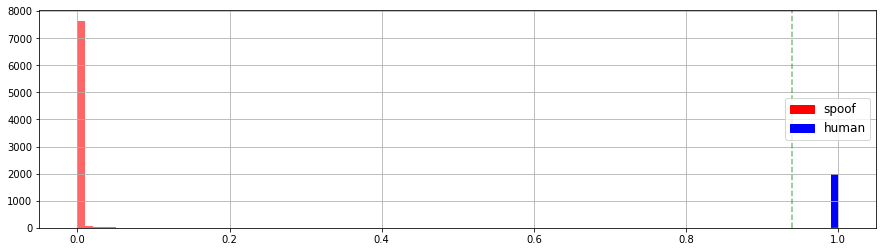

In [22]:
human = results[:len(dev_data_generator.human_paths), 0]
spoof = results[len(dev_data_generator.human_paths):, 0]

print(len(human))
print(len(spoof))

eer, threshold = Metrics.compute_err(human, spoof)

print("\nEER = %0.3f %%   @  %0.3f" % (eer, threshold))

plt.figure(figsize=(15, 4))
plt.hist(human, 99, facecolor='b', alpha=1)
plt.hist(spoof, 99, facecolor='r', alpha=0.6)
red_patch = patches.Patch(color='red', label='spoof')
blue_patch = patches.Patch(color='blue', label='human')
plt.axvline(x=threshold, linestyle='--', color='g', alpha=0.5)
plt.legend(handles=[red_patch, blue_patch], loc=5, fontsize=12)
plt.grid(True)
plt.show()

# Keras Baseline Engine for VAS Challenge 2019

In [3]:
DftSpectrogram

<module 'DftSpectrogram' from '/home/ilya/Documents/kaggle/audio/idrnd_antispoof_Baseline ID R&D/Baseline ID R&D/DftSpectrogram.py'>

In [23]:
import os
import time
import numpy as np
import pandas as pd
import scipy.io as sio
from scipy.fftpack import fft
from IPython.display import display

import pywt
import scipy.stats

import datetime as dt
from collections import defaultdict, Counter

from sklearn.ensemble import RandomForestClassifier

In [40]:
def calculate_entropy(list_values):
    counter_values = Counter(list_values).most_common()
    probabilities = [elem[1]/len(list_values) for elem in counter_values]
    entropy=scipy.stats.entropy(probabilities)
    return entropy

@numba.njit()
def calculate_statistics(list_values):
    n5 = np.nanpercentile(list_values, 5)
    n25 = np.nanpercentile(list_values, 25)
    n75 = np.nanpercentile(list_values, 75)
    n95 = np.nanpercentile(list_values, 95)
    median = np.nanpercentile(list_values, 50)
    mean = np.nanmean(list_values)
    std = np.nanstd(list_values)
    var = np.nanvar(list_values)
    rms = np.nanmean(np.sqrt(list_values**2))
    return [n5, n25, n75, n95, median, mean, std, var, rms]

def calculate_crossings(list_values):
    zero_crossing_indices = np.nonzero(np.diff(np.array(list_values) > 0))[0]
    no_zero_crossings = len(zero_crossing_indices)
    mean_crossing_indices = np.nonzero(np.diff(np.array(list_values) > np.nanmean(list_values)))[0]
    no_mean_crossings = len(mean_crossing_indices)
    return [no_zero_crossings, no_mean_crossings]

def get_features(list_values):
    entropy = calculate_entropy(list_values)
    crossings = calculate_crossings(list_values)
    statistics = calculate_statistics(list_values)
    return [entropy] + crossings + statistics

@numba.jit()
def get_uci_har_features(dataset, labels, waveletname):
    uci_har_features = []
    for signal_no in numba.prange(0, len(dataset)):
        features = []
        for signal_comp in numba.prange(0,dataset.shape[2]):
            signal = dataset[signal_no, :, signal_comp]
            list_coeff = pywt.wavedec(signal, waveletname)
            for coeff in list_coeff:
                features += get_features(coeff)
        uci_har_features.append(features)
    X = np.array(uci_har_features)
    Y = np.array(labels)
    return X, Y

def get_train_test(df, y_col, x_cols, ratio):
    """ 
    This method transforms a dataframe into a train and test set, for this you need to specify:
    1. the ratio train : test (usually 0.7)
    2. the column with the Y_values
    """
    np.random.seed = 42
    mask = np.random.rand(len(df)) < ratio
    df_train = df[mask]
    df_test = df[~mask]
       
    Y_train = df_train[y_col].values
    Y_test = df_test[y_col].values
    X_train = df_train.iloc[:,x_cols].values
    X_test = df_test.iloc[:,x_cols].values
    return df_train, df_test, X_train, Y_train, X_test, Y_test

In [28]:
spoof = train_spoof+google_spoof+g_train[1507:]

In [29]:
human = train_human+google_human+g_train[:1507]

In [27]:
google_human = pickle.load(open('human_map','rb'))
google_spoof = pickle.load(open('spoof_map','rb'))

In [1]:
import lightgbm as lgb
from sklearn.metrics import roc_auc_score
import pickle

In [41]:
def process(data):
    pathes = data[0]['pathes']
    lables = data[0]['lables']
    list_features = []
    
    for signal_id in tqdm.tqdm(pathes):
        signal = get_feature(signal_id, length=8000, random_start=True,extractor=data[0]['extractor'])
        try:
            features = []
            for wav_ in ['db5','sym5']:
                list_coeff = pywt.wavedec(signal, wav_)
                for coeff in list_coeff:
                    features += get_features(coeff)
            features.append(lables)
            list_features.append(features)
        except:
            print('kek')
        
            
    return np.array(list_features)

In [42]:
agg_list = [
    {'pathes' : train_spoof,
    'lables' : 0,
    'extractor': extract_wav},
    
    {'pathes' : google_spoof,
    'lables' : 0,
    'extractor': extract_flax},
    
    {'pathes' : g_train[1507:],
    'lables' : 0,
    'extractor': extract_wav},
    
    {'pathes' : train_human,
    'lables' : 1,
    'extractor': extract_wav},
    
    {'pathes' : google_human,
    'lables' : 1,
    'extractor': extract_flax},
    
    {'pathes' : g_train[:1507],
    'lables' : 1,
    'extractor': extract_wav},
    
    {'pathes' : libri_data[:40000],
    'lables' : 1,
    'extractor': extract_flax}
]

In [47]:
df_split = np.array_split(agg_list, 7)
pool = Pool(7)
___ = np.concatenate(pool.map(process, df_split))
pool.close()
pool.join()

100%|██████████| 109816/109816 [23:00<00:00, 79.56it/s] 


In [ ]:
# list_labels = []
# list_features = []

# for list_, lable in zip((spoof,human), (1,0)):
#     for _, signal_id in enumerate(tqdm.tqdm(list_)):
#         signal = get_feature(signal_id, length=16000, random_start=True)
#         try:
#             features = []
#             for wav_ in ['db5','sym5']:
#                 list_coeff = pywt.wavedec(signal, wav_)

#                 for coeff in list_coeff:
#                     features += get_features(coeff)
#             list_features.append(features)
#         except:
#             print('Error')
#         else:
#             list_labels.append(lable)
        
        
# # df = pd.DataFrame(list_features)
# # ycol = 'y'
# # xcols = list(range(df.shape[1]))
# # df.loc[:,ycol] = list_labels

# # df_train, df_test, X_train, Y_train, X_test, Y_test = get_train_test(df, ycol, xcols, ratio = 0.5)

 20%|██        | 40275/201005 [11:33<23:02, 116.27it/s] 

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1000137.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1000648.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1000824.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1001074.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1001114.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1001169.flac: F

 20%|██        | 40988/201005 [11:33<11:37, 229.54it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1298098.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1298220.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1298553.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1299318.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1299456.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1299678.flac: F

 21%|██        | 41700/201005 [11:33<06:02, 438.93it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1589546.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1590397.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1591047.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1591062.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1591146.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1591227.flac: F

 21%|██        | 42378/201005 [11:33<03:20, 789.96it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1848037.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1848099.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1848402.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1848422.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1848533.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_1849030.flac: F

 21%|██▏       | 43084/201005 [11:33<02:00, 1306.02it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2132599.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2133317.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2133585.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2134158.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2134162.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2134263.flac: F

 22%|██▏       | 43800/201005 [11:34<01:23, 1883.60it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2389873.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2390339.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2390873.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2391061.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2391268.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2391526.flac: F

 22%|██▏       | 44520/201005 [11:34<01:02, 2492.99it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2662621.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2663173.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2664443.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2664580.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2665462.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2665839.flac: F

 23%|██▎       | 45243/201005 [11:34<00:53, 2933.21it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2949133.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2949196.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2949772.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2949940.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2951940.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_2952225.flac: F

 23%|██▎       | 45961/201005 [11:34<00:48, 3208.18it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3221197.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3221720.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3221904.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3222856.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3224075.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3224180.flac: F

 23%|██▎       | 46677/201005 [11:34<00:45, 3371.60it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3494227.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3494462.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3494883.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3495102.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3496060.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3496319.flac: F

 24%|██▎       | 47397/201005 [11:35<00:44, 3471.65it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3774144.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3774356.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3774983.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3775083.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3775235.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_3775779.flac: F

 24%|██▍       | 48116/201005 [11:35<00:44, 3460.22it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4044890.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4045467.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4045532.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4045576.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4046256.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4047067.flac: F

 24%|██▍       | 48467/201005 [11:35<00:44, 3449.99it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4314935.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4315319.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4315523.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4317473.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4317536.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4317553.flac: F

 24%|██▍       | 49152/201005 [11:35<00:46, 3299.13it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4568651.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4569408.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4570150.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4570364.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4571277.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4571454.flac: F

 25%|██▍       | 49861/201005 [11:35<00:44, 3412.66it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4846130.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4846414.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4846659.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4846759.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4847019.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_4847662.flac: F

 25%|██▌       | 50549/201005 [11:36<00:45, 3299.73it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5115337.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5115636.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5116479.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5116902.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5117515.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5117949.flac: F

 25%|██▌       | 51214/201005 [11:36<00:46, 3228.94it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5363473.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5363485.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5363668.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5363951.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5364796.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5365228.flac: F

 26%|██▌       | 51885/201005 [11:36<00:45, 3295.84it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5610637.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5610726.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5611171.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5611591.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5611826.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5612065.flac: F

 26%|██▌       | 52576/201005 [11:36<00:43, 3378.46it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5886974.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5889527.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5889707.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5890266.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5890281.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_5890874.flac: F

 27%|██▋       | 53279/201005 [11:36<00:42, 3449.68it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6182459.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6183805.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6183867.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6183922.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6185353.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6185430.flac: F

 27%|██▋       | 54000/201005 [11:37<00:41, 3505.59it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6471949.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6472494.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6472537.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6473633.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6473657.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6473950.flac: F

 27%|██▋       | 54729/201005 [11:37<00:41, 3540.86it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6745099.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6746889.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6747050.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6747076.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6747527.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_6747901.flac: F

 28%|██▊       | 55424/201005 [11:37<00:43, 3339.70it/s]


Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7018930.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7018961.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7019076.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7019591.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7019985.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7020532.

 28%|██▊       | 56083/201005 [11:37<00:47, 3065.32it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7242347.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7243296.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7243556.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7243891.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7244025.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7244154.flac: F

 28%|██▊       | 56799/201005 [11:37<00:43, 3301.51it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7458482.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7458557.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7459071.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7459182.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7459331.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7459552.flac: F

 29%|██▊       | 57462/201005 [11:38<00:44, 3260.98it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7743020.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7743204.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7743702.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7743868.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7744329.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7744399.flac: F

 29%|██▉       | 57790/201005 [11:38<00:46, 3073.98it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7994901.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7995016.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7995041.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7995242.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7995511.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_7995735.flac: F

 29%|██▉       | 58453/201005 [11:38<00:45, 3119.71it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8209247.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8209500.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8210298.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8211464.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8211829.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8214109.flac: F

 29%|██▉       | 59166/201005 [11:38<00:42, 3339.12it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8477648.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8477808.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8478258.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8478850.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8478926.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8479186.flac: F

 30%|██▉       | 59880/201005 [11:38<00:40, 3461.82it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8764750.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8764915.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8764937.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8765986.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8766763.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_8767828.flac: F

 30%|███       | 60599/201005 [11:39<00:40, 3506.13it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9042300.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9042718.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9042927.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9044184.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9045217.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9045519.flac: F

 31%|███       | 61315/201005 [11:39<00:39, 3500.92it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9339419.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9339793.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9340433.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9340900.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9341387.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9342047.flac: F

 31%|███       | 62033/201005 [11:39<00:39, 3481.61it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9628764.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9628969.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9629343.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9630097.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9630296.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9630745.flac: F

 31%|███       | 62722/201005 [11:39<00:44, 3118.96it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9915121.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9915268.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9915412.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9915654.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9915774.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_train/flac/LA_T_9916206.flac: F

 32%|███▏      | 63438/201005 [11:39<00:41, 3339.64it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1136030.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1136051.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1137303.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1138261.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1138393.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1138529.flac: File format b

 32%|███▏      | 64181/201005 [11:40<00:38, 3523.82it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1434059.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1434283.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1434547.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1434551.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1434780.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1434936.flac: File format b

 32%|███▏      | 64894/201005 [11:40<00:39, 3433.92it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1751918.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1751935.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1752177.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1752505.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1752633.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_1753007.flac: File format b

 33%|███▎      | 65600/201005 [11:40<00:39, 3467.12it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2018291.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2018773.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2019341.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2019608.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2019701.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2020279.flac: File format b

 33%|███▎      | 66302/201005 [11:40<00:39, 3398.45it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2301862.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2304090.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2304250.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2304305.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2305845.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2306690.flac: File format b

 33%|███▎      | 66644/201005 [11:40<00:41, 3269.47it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2553532.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2554631.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2554799.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2554943.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2555710.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2555715.flac: File format b

 34%|███▎      | 67345/201005 [11:41<00:39, 3348.96it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2808783.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2808846.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2809182.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2809588.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2810400.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_2810734.flac: File format b

 34%|███▍      | 68041/201005 [11:41<00:39, 3353.03it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3081705.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3081777.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3081964.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3082795.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3082988.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3083417.flac: File format b

 34%|███▍      | 68716/201005 [11:41<00:40, 3258.51it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3349453.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3349461.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3349542.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3350240.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3351086.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3352586.flac: File format b

 35%|███▍      | 69370/201005 [11:41<00:41, 3161.37it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3608783.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3608947.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3609350.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3609505.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3610609.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3610743.flac: File format b

 35%|███▍      | 70064/201005 [11:41<00:39, 3295.45it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3854807.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3855845.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3856735.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3857047.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3857630.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_3858259.flac: File format b

 35%|███▌      | 70736/201005 [11:42<00:39, 3303.27it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4153076.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4154332.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4155281.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4155696.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4155987.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4156385.flac: File format b

 36%|███▌      | 71404/201005 [11:42<00:39, 3270.24it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4429694.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4430284.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4430544.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4430789.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4431110.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4432534.flac: File format b

 36%|███▌      | 72090/201005 [11:42<00:39, 3303.88it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4694664.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4694886.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4696311.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4697088.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4697959.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4698298.flac: File format b

 36%|███▌      | 72750/201005 [11:42<00:40, 3203.81it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4943344.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4943612.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4944706.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4945200.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4945642.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_4946274.flac: File format b

 37%|███▋      | 73434/201005 [11:42<00:38, 3292.35it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5200643.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5201039.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5201713.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5202763.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5203599.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5203690.flac: File format b

 37%|███▋      | 74100/201005 [11:43<00:38, 3306.81it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5470214.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5470298.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5470881.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5470929.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5471746.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5471947.flac: File format b

 37%|███▋      | 74796/201005 [11:43<00:37, 3393.07it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5746299.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5746789.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5747601.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5748042.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5748144.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_5748339.flac: File format b

 38%|███▊      | 75466/201005 [11:43<00:39, 3210.93it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6042592.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6042706.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6043622.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6044580.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6044584.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6045245.flac: File format b

 38%|███▊      | 76144/201005 [11:43<00:38, 3230.15it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6286091.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6286681.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6286913.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6286932.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6287077.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6287117.flac: File format b

 38%|███▊      | 76833/201005 [11:43<00:37, 3336.79it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6553908.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6554548.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6555487.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6556225.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6556306.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6556577.flac: File format b

 39%|███▊      | 77529/201005 [11:44<00:36, 3411.30it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6847229.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6847296.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6847306.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6849663.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6850195.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_6850823.flac: File format b

 39%|███▉      | 78214/201005 [11:44<00:36, 3362.46it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7124167.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7124239.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7124246.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7125248.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7125569.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7125605.flac: File format b

 39%|███▉      | 78552/201005 [11:44<00:38, 3191.54it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7374784.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7375023.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7375499.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7375721.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7375840.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7376410.flac: File format b

 39%|███▉      | 79194/201005 [11:44<00:38, 3157.70it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7604149.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7604548.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7604595.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7604669.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7605675.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7606081.flac: File format b

 40%|███▉      | 79857/201005 [11:44<00:37, 3216.28it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7834326.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7834333.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7834454.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7835394.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7835570.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_7836019.flac: File format b

 40%|████      | 80561/201005 [11:45<00:35, 3373.01it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8114334.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8114692.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8115137.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8115280.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8115585.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8115950.flac: File format b

 40%|████      | 81236/201005 [11:45<00:36, 3297.30it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8385680.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8386102.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8387087.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8387772.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8387799.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8388061.flac: File format b

 41%|████      | 81895/201005 [11:45<00:38, 3084.28it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8660630.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8660957.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8661001.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8661283.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8663420.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8663431.flac: File format b

 41%|████      | 82581/201005 [11:45<00:36, 3215.93it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8880932.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8881042.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8881354.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8882131.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8882807.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_8884259.flac: File format b

 41%|████▏     | 83261/201005 [11:45<00:36, 3234.71it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9178466.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9178575.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9178673.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9179746.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9180019.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9180251.flac: File format b

 42%|████▏     | 83952/201005 [11:46<00:35, 3297.83it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9451053.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9451208.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9451389.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9451445.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9452677.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9452684.flac: File format b

 42%|████▏     | 84601/201005 [11:46<00:38, 3005.04it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9720372.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9720674.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9720984.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9721422.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9721837.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9721880.flac: File format b

 42%|████▏     | 84926/201005 [11:46<00:37, 3070.22it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9945660.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9946370.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9947258.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9947625.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9947633.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_dev/flac/LA_D_9947685.flac: File format b

 43%|████▎     | 85559/201005 [11:46<00:38, 2991.49it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1037676.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1037975.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1037984.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1038220.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1038440.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1038670.flac: File fo

 43%|████▎     | 86239/201005 [11:46<00:35, 3194.67it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1123039.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1123121.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1123331.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1123409.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1123498.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1123589.flac: File fo

 43%|████▎     | 86934/201005 [11:47<00:34, 3325.54it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1218975.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1219086.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1219619.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1219773.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1219879.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1219978.flac: File fo

 44%|████▎     | 87638/201005 [11:47<00:33, 3420.35it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1320317.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1320351.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1320433.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1320625.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1320862.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1320932.flac: File fo

 44%|████▍     | 88346/201005 [11:47<00:33, 3376.61it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1414707.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1414739.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1414846.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1414945.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1415008.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1415059.flac: File fo

 44%|████▍     | 89060/201005 [11:47<00:32, 3444.25it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1507852.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1507920.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1508274.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1508404.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1508411.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1508716.flac: File fo

 45%|████▍     | 89749/201005 [11:47<00:33, 3363.37it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1612753.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1612855.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1613051.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1613310.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1613377.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1613498.flac: File fo

 45%|████▍     | 90421/201005 [11:48<00:33, 3277.57it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1707136.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1707194.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1707499.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1707685.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1707775.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1707897.flac: File fo

 45%|████▌     | 91118/201005 [11:48<00:33, 3296.78it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1796917.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1796952.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1797204.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1797304.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1797366.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1797461.flac: File fo

 46%|████▌     | 91796/201005 [11:48<00:32, 3339.93it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1893585.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1893767.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1894078.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1894331.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1894508.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1894712.flac: File fo

 46%|████▌     | 92458/201005 [11:48<00:33, 3219.12it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1984487.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1984518.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1984559.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1984590.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1984599.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_1984783.flac: File fo

 46%|████▋     | 93103/201005 [11:49<00:34, 3130.06it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2070809.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2070846.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2070984.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2071071.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2071256.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2071570.flac: File fo

 47%|████▋     | 93780/201005 [11:49<00:33, 3198.64it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2155671.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2155699.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2155830.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2156023.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2156461.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2156523.flac: File fo

 47%|████▋     | 94469/201005 [11:49<00:32, 3320.48it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2247680.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2247728.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2248051.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2248210.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2248216.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2248320.flac: File fo

 47%|████▋     | 94827/201005 [11:49<00:31, 3393.19it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2345020.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2345144.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2345191.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2345298.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2345562.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2345756.flac: File fo

 48%|████▊     | 95526/201005 [11:49<00:31, 3354.89it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2437421.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2437863.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2437944.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2437956.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2438276.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2438379.flac: File fo

 48%|████▊     | 96236/201005 [11:49<00:30, 3456.62it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2538563.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2538735.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2538998.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2539080.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2539166.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2539520.flac: File fo

 48%|████▊     | 96953/201005 [11:50<00:30, 3459.83it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2642846.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2642930.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2643113.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2643339.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2643410.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2643659.flac: File fo

 49%|████▊     | 97641/201005 [11:50<00:30, 3347.56it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2739139.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2739140.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2739292.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2739387.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2739533.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2739616.flac: File fo

 49%|████▉     | 98308/201005 [11:50<00:31, 3285.27it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2833287.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2833366.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2833486.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2833634.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2834042.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2834105.flac: File fo

 49%|████▉     | 98954/201005 [11:50<00:33, 3015.68it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2920155.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2920166.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2920490.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2920570.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2920762.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2921262.flac: File fo

 50%|████▉     | 99561/201005 [11:51<00:33, 3007.42it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2999081.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2999197.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2999214.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2999297.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2999799.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_2999954.flac: File fo

 50%|████▉     | 100152/201005 [11:51<00:35, 2850.84it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3081699.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3081931.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3082045.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3082058.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3082564.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3082798.flac: File fo

 50%|█████     | 100727/201005 [11:51<00:35, 2790.99it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3160926.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3160974.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3161577.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3161710.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3161859.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3161907.flac: File fo

 50%|█████     | 101390/201005 [11:51<00:32, 3037.38it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3236379.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3236450.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3236471.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3236505.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3236638.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3236831.flac: File fo

 51%|█████     | 102117/201005 [11:51<00:29, 3319.36it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3332470.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3332826.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3333142.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3333183.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3333470.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3333476.flac: File fo

 51%|█████     | 102836/201005 [11:52<00:28, 3463.14it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3436566.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3436623.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3436736.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3436816.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3436928.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3436959.flac: File fo

 52%|█████▏    | 103549/201005 [11:52<00:28, 3455.76it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3542334.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3542555.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3542560.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3542792.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3542818.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3542838.flac: File fo

 52%|█████▏    | 104242/201005 [11:52<00:28, 3433.99it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3639029.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3639334.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3639466.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3639742.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3640067.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3640145.flac: File fo

 52%|█████▏    | 104587/201005 [11:52<00:29, 3313.83it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3736645.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3736769.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3736806.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3736899.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3736971.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3737188.flac: File fo

 52%|█████▏    | 105253/201005 [11:52<00:29, 3295.34it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3818661.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3818722.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3818913.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3818917.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3818933.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3818948.flac: File fo

 53%|█████▎    | 105920/201005 [11:52<00:29, 3272.57it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3915595.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3915603.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3915861.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3916009.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3916055.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_3916094.flac: File fo

 53%|█████▎    | 106606/201005 [11:53<00:28, 3344.57it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4007701.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4007726.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4007759.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4007937.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4008149.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4008249.flac: File fo

 53%|█████▎    | 107304/201005 [11:53<00:28, 3277.42it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4110080.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4110191.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4110341.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4110342.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4110532.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4110555.flac: File fo

 54%|█████▎    | 107951/201005 [11:53<00:30, 3093.67it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4198785.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4198807.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4199075.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4199301.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4199338.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4199464.flac: File fo

 54%|█████▍    | 108677/201005 [11:53<00:27, 3346.40it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4298750.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4298763.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4299102.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4299196.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4299307.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4299520.flac: File fo

 54%|█████▍    | 109375/201005 [11:54<00:27, 3336.39it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4402509.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4402512.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4402768.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4402796.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4402839.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4402862.flac: File fo

 55%|█████▍    | 110093/201005 [11:54<00:26, 3447.20it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4489981.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4489983.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4490101.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4490187.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4490428.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4490440.flac: File fo

 55%|█████▌    | 110814/201005 [11:54<00:26, 3451.60it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4599025.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4599039.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4599311.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4599371.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4599437.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4599551.flac: File fo

 55%|█████▌    | 111527/201005 [11:54<00:26, 3439.28it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4694447.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4694623.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4694768.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4694880.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4695586.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4695950.flac: File fo

 56%|█████▌    | 112204/201005 [11:54<00:27, 3269.11it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4793033.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4793217.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4793366.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4793374.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4793484.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4793586.flac: File fo

 56%|█████▌    | 112895/201005 [11:55<00:26, 3283.72it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4883406.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4883492.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4883882.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4883976.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4884174.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4884308.flac: File fo

 57%|█████▋    | 113591/201005 [11:55<00:26, 3338.56it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4974429.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4975259.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4975291.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4975543.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4975687.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_4975971.flac: File fo

 57%|█████▋    | 114291/201005 [11:55<00:25, 3413.87it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5065119.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5065161.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5065361.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5065602.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5065618.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5065992.flac: File fo

 57%|█████▋    | 114635/201005 [11:55<00:26, 3247.32it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5164933.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5164958.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5164972.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5164999.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5165377.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5165404.flac: File fo

 57%|█████▋    | 115308/201005 [11:55<00:25, 3298.23it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5255670.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5255692.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5255705.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5255751.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5255877.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5255883.flac: File fo

 58%|█████▊    | 116015/201005 [11:55<00:25, 3333.21it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5355994.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5356036.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5356052.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5356632.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5356638.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5356710.flac: File fo

 58%|█████▊    | 116690/201005 [11:56<00:25, 3315.49it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5445850.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5445931.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5446411.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5446551.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5446634.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5446732.flac: File fo

 58%|█████▊    | 117356/201005 [11:56<00:25, 3277.88it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5540789.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5541086.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5541158.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5541180.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5541367.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5541537.flac: File fo

 59%|█████▊    | 118013/201005 [11:56<00:25, 3246.64it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5631315.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5631434.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5631605.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5631778.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5632091.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5632183.flac: File fo

 59%|█████▉    | 118645/201005 [11:56<00:27, 3005.36it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5719039.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5719137.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5719153.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5719269.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5719450.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5719700.flac: File fo

 59%|█████▉    | 119280/201005 [11:57<00:26, 3050.32it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5806450.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5806469.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5806478.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5806580.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5806762.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5806794.flac: File fo

 60%|█████▉    | 119976/201005 [11:57<00:25, 3226.46it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5895302.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5895406.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5895641.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5895858.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5895906.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5895917.flac: File fo

 60%|██████    | 120642/201005 [11:57<00:24, 3267.59it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5989575.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5989981.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5990233.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5990235.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5990296.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_5990385.flac: File fo

 60%|██████    | 121335/201005 [11:57<00:23, 3373.23it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6078127.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6078133.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6078180.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6078193.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6078220.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6078279.flac: File fo

 61%|██████    | 122021/201005 [11:57<00:23, 3392.19it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6175783.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6175959.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6175984.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6176002.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6176004.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6176076.flac: File fo

 61%|██████    | 122725/201005 [11:58<00:23, 3365.53it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6267035.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6267108.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6267134.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6267459.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6267696.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6267816.flac: File fo

 61%|██████▏   | 123435/201005 [11:58<00:22, 3384.27it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6360133.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6360146.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6360321.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6360538.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6360809.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6360858.flac: File fo

 62%|██████▏   | 124108/201005 [11:58<00:23, 3296.00it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6456149.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6456526.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6456682.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6456806.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6456810.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6456833.flac: File fo

 62%|██████▏   | 124834/201005 [11:58<00:21, 3462.46it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6539593.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6539838.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6539841.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6540135.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6540445.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6540567.flac: File fo

 62%|██████▏   | 125526/201005 [11:58<00:22, 3406.04it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6642723.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6642939.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6642997.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6643121.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6643168.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6643326.flac: File fo

 63%|██████▎   | 125877/201005 [11:58<00:21, 3435.91it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6740401.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6740532.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6741255.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6741285.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6741330.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6741412.flac: File fo

 63%|██████▎   | 126549/201005 [11:59<00:23, 3232.44it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6825925.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6825970.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6826131.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6826172.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6826423.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6826558.flac: File fo

 63%|██████▎   | 127211/201005 [11:59<00:22, 3235.77it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6918037.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6918202.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6918253.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6918400.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6918505.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_6918509.flac: File fo

 64%|██████▎   | 127896/201005 [11:59<00:22, 3298.12it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7016164.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7016210.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7016212.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7016303.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7016767.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7016775.flac: File fo

 64%|██████▍   | 128641/201005 [11:59<00:20, 3497.45it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7109134.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7109202.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7109274.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7109379.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7109834.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7109838.flac: File fo

 64%|██████▍   | 129362/201005 [12:00<00:21, 3370.44it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7213218.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7213446.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7213528.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7213603.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7213636.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7213639.flac: File fo

 65%|██████▍   | 130079/201005 [12:00<00:20, 3430.67it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7298285.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7298399.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7298446.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7298485.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7298648.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7298696.flac: File fo

 65%|██████▌   | 130780/201005 [12:00<00:20, 3346.35it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7404524.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7404689.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7404840.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7404903.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7405109.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7405314.flac: File fo

 65%|██████▌   | 131485/201005 [12:00<00:20, 3440.70it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7488738.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7488796.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7488951.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7489105.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7489347.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7489471.flac: File fo

 66%|██████▌   | 132183/201005 [12:00<00:20, 3420.38it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7588053.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7588108.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7588528.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7588961.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7589036.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7589088.flac: File fo

 66%|██████▌   | 132877/201005 [12:01<00:19, 3436.33it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7687329.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7687373.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7687829.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7687951.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7687998.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7688011.flac: File fo

 66%|██████▋   | 133563/201005 [12:01<00:20, 3212.30it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7776809.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7776815.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7776963.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7777022.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7777069.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7777312.flac: File fo

 67%|██████▋   | 134276/201005 [12:01<00:19, 3386.85it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7859820.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7859908.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7860615.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7860675.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7860723.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7860799.flac: File fo

 67%|██████▋   | 134618/201005 [12:01<00:20, 3269.32it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7958682.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7958709.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7958927.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7958950.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7959155.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_7959201.flac: File fo

 67%|██████▋   | 135291/201005 [12:01<00:20, 3260.63it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8042163.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8042307.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8042403.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8042569.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8043013.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8043133.flac: File fo

 68%|██████▊   | 135943/201005 [12:02<00:20, 3179.05it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8137952.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8138490.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8138495.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8138570.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8138578.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8138731.flac: File fo

 68%|██████▊   | 136580/201005 [12:02<00:20, 3144.63it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8227311.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8227387.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8227564.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8227790.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8227913.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8227977.flac: File fo

 68%|██████▊   | 137304/201005 [12:02<00:18, 3363.41it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8320483.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8320603.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8321149.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8321179.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8321249.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8321324.flac: File fo

 69%|██████▊   | 137996/201005 [12:02<00:19, 3268.67it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8424299.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8424331.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8424407.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8424506.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8424613.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8424647.flac: File fo

 69%|██████▉   | 138669/201005 [12:02<00:19, 3244.38it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8513099.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8513116.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8513518.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8513666.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8513681.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8513837.flac: File fo

 69%|██████▉   | 139341/201005 [12:03<00:18, 3279.67it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8608989.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8609077.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8609495.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8610256.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8610288.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8610373.flac: File fo

 70%|██████▉   | 140040/201005 [12:03<00:18, 3359.36it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8700093.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8700438.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8700691.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8701106.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8701155.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8701303.flac: File fo

 70%|███████   | 140739/201005 [12:03<00:17, 3423.66it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8801991.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8802306.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8802309.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8802350.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8802601.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8802811.flac: File fo

 70%|███████   | 141457/201005 [12:03<00:16, 3509.34it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8901728.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8901786.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8902036.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8902361.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8902834.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_8902848.flac: File fo

 71%|███████   | 142160/201005 [12:03<00:17, 3342.70it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9005688.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9005703.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9005729.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9005783.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9005965.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9006092.flac: File fo

 71%|███████   | 142832/201005 [12:04<00:17, 3274.84it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9084373.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9084885.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9084956.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9084984.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9085063.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9085378.flac: File fo

 71%|███████▏  | 143489/201005 [12:04<00:17, 3250.17it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9173543.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9173853.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9174106.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9174168.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9174219.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9174290.flac: File fo

 72%|███████▏  | 144148/201005 [12:04<00:17, 3246.47it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9263153.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9263261.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9263352.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9263489.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9263623.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9264006.flac: File fo

 72%|███████▏  | 144844/201005 [12:04<00:16, 3370.90it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9356058.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9356174.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9356401.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9356605.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9356653.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9356663.flac: File fo

 72%|███████▏  | 145521/201005 [12:04<00:16, 3340.11it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9452810.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9452918.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9452979.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9452980.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9453205.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9453229.flac: File fo

 73%|███████▎  | 146245/201005 [12:05<00:16, 3270.49it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9544290.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9544302.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9544790.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9544880.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9544978.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9545069.flac: File fo

 73%|███████▎  | 146956/201005 [12:05<00:15, 3410.75it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9638883.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9639031.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9639058.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9639133.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9639202.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9639376.flac: File fo

 73%|███████▎  | 147313/201005 [12:05<00:15, 3454.71it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9735947.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9736028.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9736204.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9736504.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9736511.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9736705.flac: File fo

 74%|███████▎  | 148014/201005 [12:05<00:15, 3400.80it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9842111.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9842142.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9842278.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9842291.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9842376.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9842378.flac: File fo

 74%|███████▍  | 148680/201005 [12:05<00:17, 3066.99it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9928092.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9928223.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9928530.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9928635.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9928854.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_9929170.flac: File fo

 74%|███████▍  | 149316/201005 [12:06<00:16, 3041.18it/s]

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A1798025.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A1805932.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A1806024.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A1831517.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A1853447.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A1871167.flac: F

Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A9936942.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A9940557.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A9965149.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A9967055.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A9970430.flac: File format b'fLaC'... not understood.
Error
Error with getting feature from /home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_eval/flac/LA_E_A9975938.flac: F

 76%|███████▌  | 152485/201005 [13:03<16:14, 49.78it/s]  

In [50]:
df = pd.DataFrame(___[:,:-1])
ycol = 'y'
xcols = list(range(df.shape[1]))
df.loc[:,ycol] = ___[:,-1]

In [51]:
df.replace([np.inf, -np.inf], np.nan, inplace=True)

In [52]:
df.fillna(0, inplace = True)
df = df.astype('float64')

In [53]:
df_train, df_test, X_train, Y_train, X_test, Y_test = get_train_test(df, ycol, xcols, ratio = 0.5)

In [54]:
'db5',- 0.884
'sym5' - 0.87
'coif5', 0.8865
'bior2.4'

TypeError: unsupported operand type(s) for -: 'str' and 'float'

In [70]:
gbm.save_model('LightGBM_2')

In [69]:
lgb_train = lgb.Dataset(X_test, Y_test)
lgb_eval = lgb.Dataset(X_train, Y_train, reference=lgb_train)

# specify your configurations as a dict
params = {
    'metric': {'l2', 'l1'},
    'num_leaves': 500,
    'learning_rate': 0.05,
    'feature_fraction': 0.9,
    'bagging_fraction': 0.9,
    'bagging_freq': 100,
    'verbose': 0
}


gbm = lgb.train(params,
                lgb_train,
                num_boost_round=150,
                valid_sets=lgb_eval,
                early_stopping_rounds=15)


y_pred_train = gbm.predict(X_test, num_iteration=gbm.best_iteration)
y_pred_test = gbm.predict(X_train, num_iteration=gbm.best_iteration)

train_score = roc_auc_score(Y_test,y_pred_train)
test_score = roc_auc_score( Y_train,y_pred_test)
print("The Train Score is {}".format(train_score))
print("The Test Score is {}".format(test_score))


[1]	valid_0's l1: 0.410077	valid_0's l2: 0.200878
Training until validation scores don't improve for 15 rounds.
[2]	valid_0's l1: 0.402264	valid_0's l2: 0.193598
[3]	valid_0's l1: 0.394079	valid_0's l2: 0.186299
[4]	valid_0's l1: 0.386239	valid_0's l2: 0.179614
[5]	valid_0's l1: 0.37874	valid_0's l2: 0.173456
[6]	valid_0's l1: 0.371625	valid_0's l2: 0.167924
[7]	valid_0's l1: 0.364788	valid_0's l2: 0.162831
[8]	valid_0's l1: 0.358368	valid_0's l2: 0.158175
[9]	valid_0's l1: 0.352053	valid_0's l2: 0.15383
[10]	valid_0's l1: 0.346075	valid_0's l2: 0.14983
[11]	valid_0's l1: 0.340359	valid_0's l2: 0.14621
[12]	valid_0's l1: 0.334911	valid_0's l2: 0.142846
[13]	valid_0's l1: 0.329614	valid_0's l2: 0.139672
[14]	valid_0's l1: 0.324532	valid_0's l2: 0.136742
[15]	valid_0's l1: 0.319627	valid_0's l2: 0.134024
[16]	valid_0's l1: 0.314946	valid_0's l2: 0.131533
[17]	valid_0's l1: 0.310411	valid_0's l2: 0.129194
[18]	valid_0's l1: 0.30611	valid_0's l2: 0.127026
[19]	valid_0's l1: 0.302091	valid_

In [ ]:
0.9374204386145256

In [207]:
dataset_dir = "/home/ilya/Documents/kaggle/audio/Training_Data/LA"
train_dataset_dir = os.path.join(dataset_dir, "ASVspoof2019_LA_cm_protocols")

!tree {train_dataset_dir} -L 1

/home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_cm_protocols
├── ASVspoof2019.LA.cm.dev.trl.txt
├── ASVspoof2019.LA.cm.eval.trl.txt
└── ASVspoof2019.LA.cm.train.trn.txt

0 directories, 3 files


In [39]:
g_dev_map = pd.read_csv(
    '/home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_cm_protocols/ASVspoof2019.LA.cm.dev.trl.txt',
    sep = ' ', header=None)
g_train_map = pd.read_csv(
    '/home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_cm_protocols/ASVspoof2019.LA.cm.train.trn.txt',
    sep = ' ', header=None)
g_eval_map = pd.read_csv(
    '/home/ilya/Documents/kaggle/audio/Training_Data/LA/ASVspoof2019_LA_cm_protocols/ASVspoof2019.LA.cm.eval.trl.txt',
    sep = ' ', header=None)

In [56]:
len(google_human) - g_eval_map[4].value_counts()['bonafide'] - g_train_map[4].value_counts()['bonafide']  - g_dev_map[4].value_counts()['bonafide']

0